# Image Classification Using a Deep CNN

In this notebook, we classify images between alive kudzu images and dead kudzu images.

The code in this notebook is based on the repository: [ImageClassification](https://github.com/nicknochnack/ImageClassification/tree/main).

You can also refer to the tutorial on YouTube: [Image Classification Tutorial](https://youtu.be/jztwpsIzEGc).

Before running the code, make sure to download the following file and save it to your AlivevsDeadKudzu:
- `\AlivevsDeadKudzu\data1.zip`


## 1. Setup and Load Data


**Unzip Data File**

This code unzips a data file located in your Google Drive and extracts its contents into the current directory of the Colab notebook environment. The contents are 2 folders which each contains images that we downloaded from Google Images. There are 134 images with alive Kudzu vegetation and 79 images of dead Kudzu vegetation.

Usage:
- This code cell is intended to be executed only when working with a new notebook or when you need to extract the contents of a new data archive.
- The `!unzip` command is a shell command that allows you to extract files from a zip archive.
- Replace '/content/drive/MyDrive/data1.zip' with the path to the data archive you want to unzip.




In [10]:
import zipfile
import os

zip_file = r"C:\Users\Rojano\Desktop\AlivevsDeadKudzu\data.zip"
extract_folder = r"C:\Users\Rojano\Desktop\AlivevsDeadKudzu"

# Create the extract folder if it doesn't exist
os.makedirs(extract_folder, exist_ok=True)

# Extract the zip file
with zipfile.ZipFile(zip_file, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

### 1.1 Install Dependencies and Setup

Follow this tutorial if want to use GPU https://www.xda-developers.com/use-gpu-jupyter-notebook/

In [1]:
#!pip install --upgrade tensorflow keras
!pip install opencv-python matplotlib


[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
#If with current version of tensorflow doesn't work use !pip install "tensorflow<2.11"

In [3]:
# check that librareis where installed correctly. You need: tensorflow, keras, opencv-python and matplotlib
!pip list

Package                      Version
---------------------------- --------------
absl-py                      2.1.0
anyio                        4.3.0
argon2-cffi                  23.1.0
argon2-cffi-bindings         21.2.0
arrow                        1.3.0
asttokens                    2.4.1
astunparse                   1.6.3
async-lru                    2.0.4
attrs                        23.2.0
Babel                        2.14.0
beautifulsoup4               4.12.3
bleach                       6.1.0
cachetools                   5.3.3
certifi                      2024.2.2
cffi                         1.16.0
charset-normalizer           3.3.2
colorama                     0.4.6
comm                         0.2.2
contourpy                    1.2.1
cycler                       0.12.1
debugpy                      1.8.1
decorator                    5.1.1
defusedxml                   0.7.1
exceptiongroup               1.2.0
executing                    2.0.1
fastjsonschema               2.19.


[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


## GPU Set Up (skip if wanted to use CPU)

Check we are running this code with GPU by running the following code. Can be run with CPU it will just take longer.
GPU aprox time:
CPU aprox time:

In [4]:
import tensorflow as tf
gpus = tf.config.list_physical_devices("GPU")
if gpus:
    for gpu in gpus:
        print("Found a GPU with the name:", gpu)
else:
    print("Failed to detect a GPU.")

Found a GPU with the name: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [5]:
tf.test.gpu_device_name()

'/device:GPU:0'

In [6]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [7]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

### 1.2 Remove Dodgy Images
Mislabeld images, currupt images.

In [8]:
import os
import cv2
import imghdr
from matplotlib import pyplot as plt

In [9]:
data_dir = 'data'

In [10]:
your_directory = "C:/Users/Rojano/Desktop"

In [11]:
# Joining paths using os.path.join()
data_full_path = os.path.join(your_directory, data_dir)

# Display the joined path
print("Joined path:", data_full_path)

Joined path: C:/Users/Rojano/Desktop\data


In [12]:
image_exts = ['jpeg','jpg', 'bmp', 'png']

Before running the code below, delete any image under 9KB from the folders inside the data folder. Then run the code.

In [13]:
for image_class in os.listdir(data_full_path):
    for image in os.listdir(os.path.join(data_full_path, image_class)):
        image_path = os.path.join(data_full_path, image_class, image)
        try:
            img = cv2.imread(image_path)
            tip = imghdr.what(image_path)
            if tip not in image_exts:
                print('Image not in ext list {}'.format(image_path))
                os.remove(image_path)
        except Exception as e:
            print('Issue with image {}'.format(image_path))
            # os.remove(image_path)

### 1.3 Load Data

In [14]:
import numpy as np
from matplotlib import pyplot as plt

Does preprocessing for you. If need to read more about this function run:

```
tf.keras.utils.image_dataset_from_directory??
```



In [15]:
# if we wanted to edit our data set we would do it here
data = tf.keras.utils.image_dataset_from_directory('data')

Found 447 files belonging to 2 classes.


In [16]:
# we need this because we dont have a premade dataset, allow us to access the
# generator from our data pipeline
data_iterator = data.as_numpy_iterator()

In [17]:
# get consequitive batches
batch = data_iterator.next()

In [18]:
batch[0].shape

(32, 256, 256, 3)

In [19]:
# 0 = alive kudzu, 1 = dead kudzu
batch[1]

array([0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 1, 1, 1, 0, 1, 0])

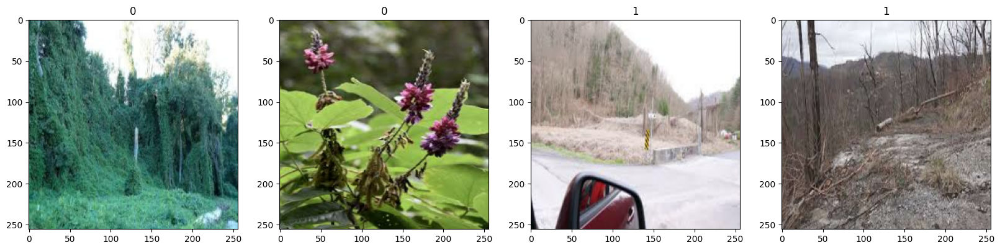

In [20]:
fig, ax = plt.subplots(ncols=4, figsize=(20,20))
for idx, img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

# 2. Preprocess

### 2.1 Scale Data

In [21]:
#Transform a data scle images ( x=images / y=target variable=labels )
data = data.map(lambda x,y: (x/255, y))

In [22]:
scaled_iterator = data.as_numpy_iterator()

#### 2.1.1 Check that our data is scaled

In [23]:
batch = scaled_iterator.next()

In [24]:
batch[0].min()

0.0

In [25]:
batch[0].max()

1.0

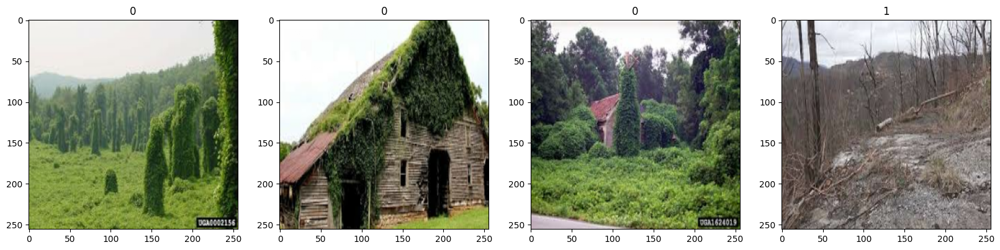

In [26]:
fig, ax = plt.subplots(ncols=4, figsize=(20,20))
for idx, img in enumerate(batch[0][:4]):
    ax[idx].imshow(img)
    ax[idx].title.set_text(batch[1][idx])

### 2.2 Split Data

In [27]:
# number of batches. Each batch has 32 images
len(data)

14

In [37]:
# addition of 3 should equal the number of batches = 9
# 80% train 10% validation 10% testing
train_size = int(len(data)*.8)
val_size = int(len(data)*.1)+1
test_size = int(len(data)*.1)

In [38]:
train_size

11

In [39]:
val_size

2

In [40]:
test_size

1

In [41]:
train_size+val_size+test_size

14

In [42]:
train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(train_size+val_size).take(test_size)

# 3. Deep Model

### 3.1 Build Deep Learning Model

In [43]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout

In [44]:
model = Sequential()

In [157]:
# 1st layer: convolution
# 16 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
# input shape looks like (256h by 256w, 3 channels deep)
model.add(Conv2D(16, (3,3), 1, activation='relu', input_shape=(256,256,3)))

# returns max value every 2 px
model.add(MaxPooling2D())


# 2nd layer: convolution
# 32 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(32, (3,3), 1, activation='relu'))

# returns max value every 2 px
model.add(MaxPooling2D())


# 3rd layer: convolution
# 16 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(16, (3,3), 1, activation='relu'))

# returns max value every 2 px
model.add(MaxPooling2D())


# converting 3 channels into 1
model.add(Flatten())

# 2 dense layers: 256 neurons, applying relu activation
model.add(Dense(256, activation='relu'))

# 1 output and result would be 0 or 1 as no imagenery or kudzu
model.add(Dense(1, activation='sigmoid'))

In [45]:
# Define AlexNet architecture
# 1st layer: convolution
# 16 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
# input shape looks like (256h by 256w, 3 channels deep)
model.add(Conv2D(16, (3,3), strides=1, activation='relu', input_shape=(256,256,3)))

# returns max value every 2 px
model.add(MaxPooling2D(pool_size=(2, 2)))

# 2nd layer: convolution
# 32 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(32, (3,3), strides=1, activation='relu'))

# returns max value every 2 px
model.add(MaxPooling2D(pool_size=(2, 2)))

# 3rd layer: convolution
# 16 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(16, (3,3), strides=1, activation='relu'))

# 4th layer: convolution
# 32 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(32, (3,3), strides=1, activation='relu'))

# 5th layer: convolution
# 16 filters, (3px by 3 px), moves 1 px each time,
# activation relu(converts any negative values to 0)
model.add(Conv2D(16, (3,3), strides=1, activation='relu'))

# returns max value every 2 px
model.add(MaxPooling2D(pool_size=(2, 2)))

# converting 3 channels into 1
model.add(Flatten())

# 1st dense layer: 256 neurons, applying relu activation
model.add(Dense(256, activation='relu'))

# 2nd dense layer: 128 neurons, applying relu activation
model.add(Dense(128, activation='relu'))

# 3rd dense layer: 64 neurons, applying relu activation
model.add(Dense(64, activation='relu'))

# 1 output layer and result would be 0 or 1 as no imagery or kudzu
model.add(Dense(1, activation='sigmoid'))



In [46]:
# adam optimizer, we have a binary classification, how well our model is classifying
model.compile('adam', loss=tf.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [47]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 62, 62, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 16)        4624      
                                                                 
 conv2d_3 (Conv2D)           (None, 58, 58, 32)        4

### 3.2 Train

In [48]:
logdir='logs'

Callbacks are useful to comeback.

In [49]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

This is the traning component

In [50]:
# epoch is how much are we gonna train our data, 1 epoch = 1 run of our entire training data
# we are going to run evaluation
# callbacks
hist = model.fit(train, epochs=20, validation_data=val, callbacks=[tensorboard_callback])

Epoch 1/20
11/11 [==============================] - 13s 175ms/step - loss: 0.6721 - accuracy: 0.6932 - val_loss: 0.5937 - val_accuracy: 0.8906
Epoch 2/20
11/11 [==============================] - 3s 195ms/step - loss: 0.4150 - accuracy: 0.8608 - val_loss: 0.1393 - val_accuracy: 0.9531
Epoch 3/20
11/11 [==============================] - 3s 193ms/step - loss: 0.2374 - accuracy: 0.9006 - val_loss: 0.2069 - val_accuracy: 0.9375
Epoch 4/20
11/11 [==============================] - 3s 202ms/step - loss: 0.1917 - accuracy: 0.9347 - val_loss: 0.1869 - val_accuracy: 0.9062
Epoch 5/20
11/11 [==============================] - 3s 197ms/step - loss: 0.1336 - accuracy: 0.9403 - val_loss: 0.1055 - val_accuracy: 0.9688
Epoch 6/20
11/11 [==============================] - 3s 199ms/step - loss: 0.1044 - accuracy: 0.9602 - val_loss: 0.1576 - val_accuracy: 0.9375
Epoch 7/20
11/11 [==============================] - 3s 194ms/step - loss: 0.0860 - accuracy: 0.9631 - val_loss: 0.1366 - val_accuracy: 0.9375
Epoch

In [78]:
hist.history

{'loss': [0.672095000743866,
  0.414974182844162,
  0.23743677139282227,
  0.19166451692581177,
  0.1336444914340973,
  0.1044231653213501,
  0.0859772115945816,
  0.23922725021839142,
  0.19707971811294556,
  0.1411622017621994,
  0.09627509862184525,
  0.07169347256422043,
  0.0763576403260231,
  0.07866471260786057,
  0.05861576646566391,
  0.127980574965477,
  0.26848819851875305,
  0.14383564889431,
  0.10428774356842041,
  0.06995920091867447],
 'accuracy': [0.6931818127632141,
  0.8607954382896423,
  0.9005681872367859,
  0.9346590638160706,
  0.9403409361839294,
  0.9602272510528564,
  0.9630681872367859,
  0.9147727489471436,
  0.9204545617103577,
  0.9403409361839294,
  0.9545454382896423,
  0.9744318127632141,
  0.9772727489471436,
  0.9715909361839294,
  0.9857954382896423,
  0.9602272510528564,
  0.8636363744735718,
  0.9573863744735718,
  0.9630681872367859,
  0.9772727489471436],
 'val_loss': [0.5937240123748779,
  0.13931867480278015,
  0.20690074563026428,
  0.18688340

### 3.3 Plot Performance

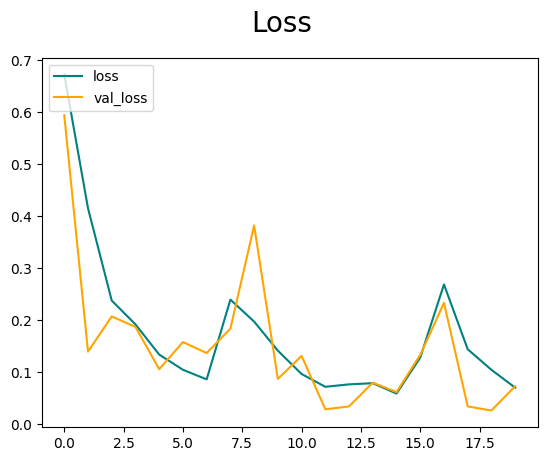

In [79]:
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

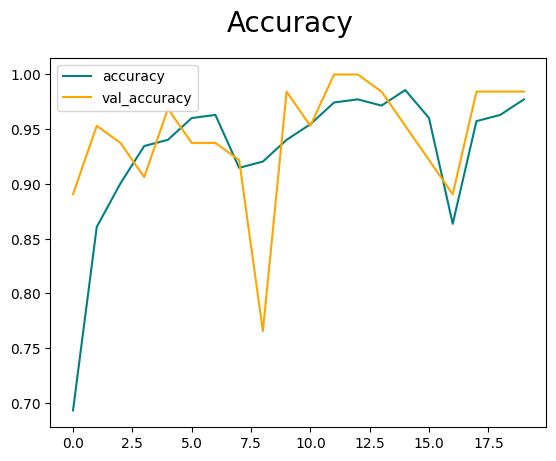

In [80]:
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

# 4. Evaluate

### 4.1 Evaluate

In [81]:
from tensorflow.keras.metrics import Precision, Recall, BinaryAccuracy

In [85]:
pre = Precision()
re = Recall()
acc = BinaryAccuracy()

In [86]:
for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    pre.update_state(y, yhat)
    re.update_state(y, yhat)
    acc.update_state(y, yhat)

1/1 [==============================] - 0s 96ms/step


In [87]:
print(f'Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}')

Precision:1.0, Recall:1.0, Accuracy:1.0


### 4.2 Test

Import libraries to test and classify the images in the output folder that we downloaded using Google Street View.

In [88]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import shutil

Define all the paths to the folder where we have all the images we downloaded and we want to classify and also the folders to save each image once is classified.

In [89]:
# Redifine you images paths
images_full_path = "C:/Users/Rojano/Desktop/AlivevsDeadKudzu/output"
alive_full_path = "C:/Users/Rojano/Desktop/alive"
dead_full_path = "C:/Users/Rojano/Desktop/dead"

# Display the joined path
print("Images path:", images_full_path)
print("Alive Images path:", alive_full_path)
print("Dead Images path:", dead_full_path)

Images path: C:/Users/Rojano/Desktop/AlivevsDeadKudzu/output
Alive Images path: C:/Users/Rojano/Desktop/alive
Dead Images path: C:/Users/Rojano/Desktop/dead


In [90]:
# List all the image files in the directory
image_files = os.listdir(images_full_path)

In [91]:
len(image_files)

3578

In [92]:
# Initialize the dictionary to store yhat values
yhat_values = {}

alive_count = 0
dead_count = 0

for image_file in image_files:
    # Read the image
    img = cv2.imread(os.path.join(images_full_path, image_file))

    # Check if the image is successfully loaded
    if img is None:
      print(f"Error: Unable to read image {image_file}")
      continue  # Skip to the next image if loading fails

    # Convert color space from BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Resize the image
    resize = tf.image.resize(img_rgb, (256, 256))

    # Preprocess the image for prediction
    preprocessed_img = resize / 255.0

    # Make predictions using the model
    yhat = model.predict(np.expand_dims(preprocessed_img, axis=0))

    # Determine the predicted class
    if yhat > 0.5:
        predicted_class = 'Dead'
        destination_folder = dead_full_path
        dead_count = dead_count + 1
        #print(f'Dead Images = {dead_count}')
    else:
        predicted_class = 'Alive'
        destination_folder = alive_full_path
        alive_count = alive_count + 1
        #print(f'Alive Images = {alive_count}')
        # Store the yhat value in the dictionary
        yhat_values[image_file] = yhat[0][0]

    # Save the image to the respective classification folder
    image_path = os.path.join(destination_folder, image_file)
    cv2.imwrite(image_path, img)

    #print(f'Image {image_file} is predicted as {predicted_class} and saved to {destination_folder}')

Error: Unable to read image Alive
Error: Unable to read image Dead
1/1 [==============================] - 0s 45ms/step


In [93]:
print(f'Alive Images = {alive_count}')
print(f'Dead Images = {dead_count}')


Alive Images = 1304
Dead Images = 2272


In [94]:
sorted_yhat_values_alive = dict(sorted(yhat_values.items(), key=lambda item: item[1]))
print(sorted_yhat_values_alive)

{'image_35.59397582_-82.54681302_90.jpg': 1.3265843e-05, 'image_33.21681985_-86.23824337_90.jpg': 6.600203e-05, 'image_29.70001481_-95.45191156_270.jpg': 8.320735e-05, 'image_38.10546358_-81.46680221_270.jpg': 9.517483e-05, 'image_35.57352568_-80.93166927_90.jpg': 0.00012230958, 'image_40.83345897_-73.69614032_0.jpg': 0.00012907319, 'image_29.70001481_-95.45191156_180.jpg': 0.00013114455, 'image_34.31615754_-89.46968126_270.jpg': 0.00013896449, 'image_32.00821686_-91.01943639_0.jpg': 0.00021900517, 'image_33.58813938_-88.87093989_0.jpg': 0.00022225651, 'image_29.87989652_-82.49263781_180.jpg': 0.00022711417, 'image_29.70001481_-95.45191156_90.jpg': 0.0002553251, 'image_34.57669296_-89.54189219_180.jpg': 0.00028699194, 'image_34.57612046_-83.31842263_0.jpg': 0.00029203223, 'image_36.77936355_-88.08317086_180.jpg': 0.00029358044, 'image_30.05942033_-84.9829459_90.jpg': 0.00033552264, 'image_31.96743594_-90.37566788_270.jpg': 0.00034725774, 'image_32.00870628_-91.03142087_180.jpg': 0.0003

# 5. Top 20%

In [74]:
import os
import cv2
import shutil

# Define the destination folder to save the images
destination_folder = "C:/Users/Rojano/Desktop/alive/top20"  # Update with the path to your destination folder

# Create the destination folder if it doesn't exist
if not os.path.exists(destination_folder):
    os.makedirs(destination_folder)

# Counter for saving the first 20% of the images
count = 0
top20 = len(sorted_yhat_values_alive) * 0.20
print(top20)


260.8


In [75]:
# Loop through the first 20% of the images in the sorted dictionary
for image_file, yhat_value in sorted_yhat_values_alive.items():
    if count >= top20:
        break

    # Copy the image file to the destination folder
    source_path = os.path.join(images_full_path, image_file)
    destination_path = os.path.join(destination_folder, image_file)
    shutil.copyfile(source_path, destination_path)

    # Increment the counter
    count += 1

print(f"First {count} images saved to the {destination_folder}.")


First 261 images saved to the C:/Users/Rojano/Desktop/alive/top20.


In [76]:
# List all files and directories in the folder
files = os.listdir(destination_folder)

# Count the number of files (excluding directories)
num_files = len(files)

print("Number of files in the folder:", num_files)


Number of files in the folder: 261


## Display images 

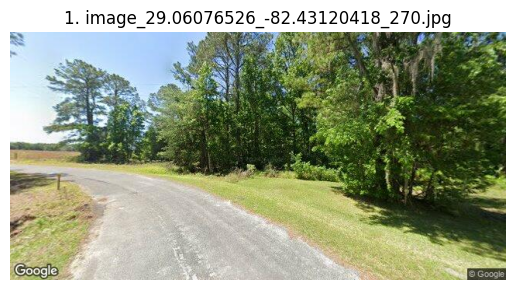

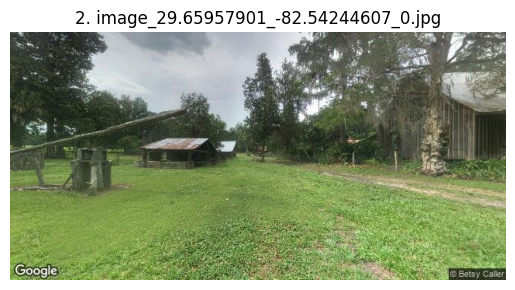

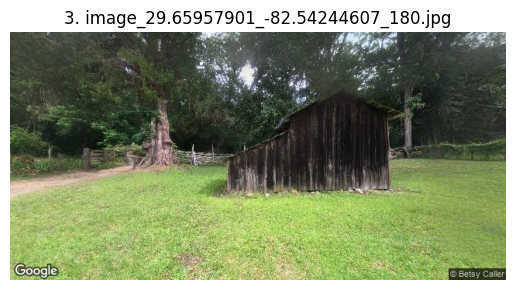

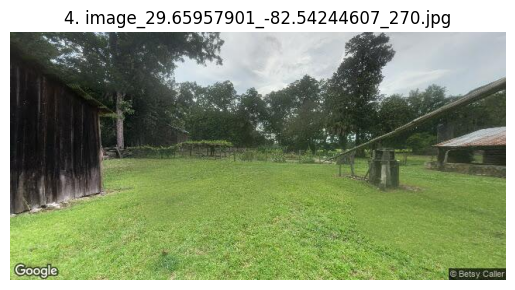

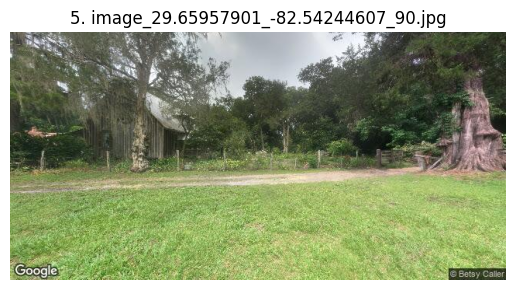

...

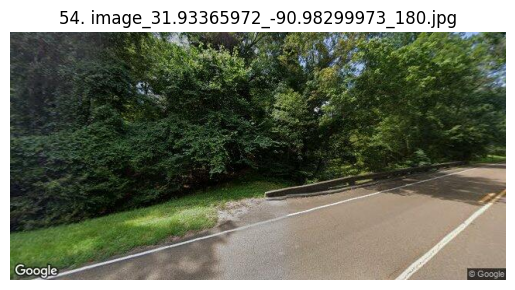

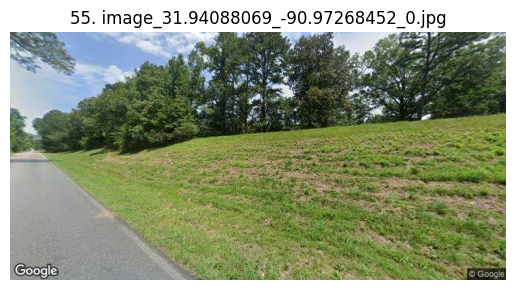

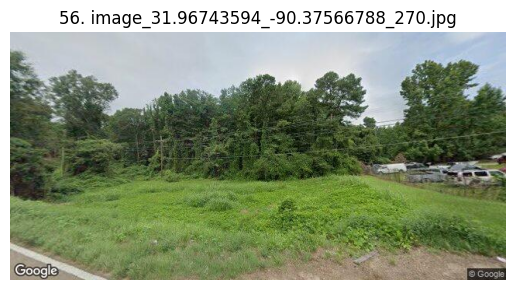

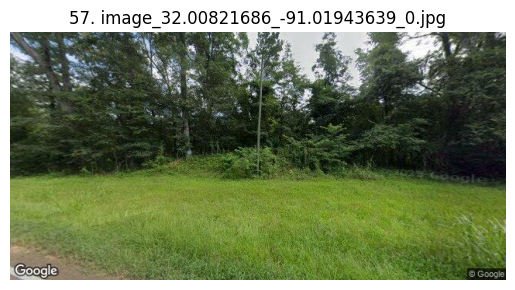

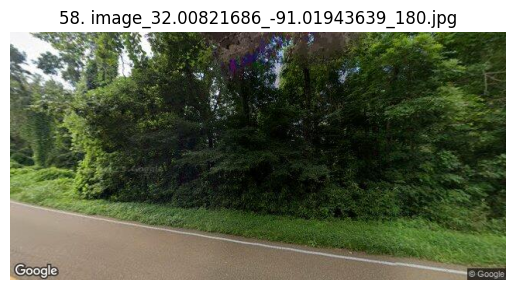

KeyboardInterrupt: 

In [77]:
# Iterate through the files in the destination folder
for count, image_file in enumerate(os.listdir(destination_folder), 1):
    # Read the image
    img = cv2.imread(os.path.join(destination_folder, image_file))

    # Display the image
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f"{count}. {image_file}")
    plt.axis('off')
    plt.show()